Jupyter notebook for plotting the results and getting the integration metrics of conos integration algoritm

Author: Erno Hänninen

Title: quantify_conos.ipynb

Created: 2022-11-29

In [2]:
import sys
import os
#sys.path.insert(0, "../../../../Scripts") #Adding a path to be able to import the jupyter_functions
#from jupyter_functions import *
import scanpy as sc





In [3]:
# Read trimester 1 data
cs13_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS13_prosencephalon")
cs14_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS14_cortex")
cs15_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS15_forebrain")
cs20_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS20_hypothalamus1")
cs22_2_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS22_2_hypothalamus")
cs22_1_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/CS22_Hypothalamus")

In [4]:
cs13_adata.var_names_make_unique()
cs14_adata.var_names_make_unique()
cs15_adata.var_names_make_unique()
cs20_adata.var_names_make_unique()
cs22_2_adata.var_names_make_unique()
cs22_1_adata.var_names_make_unique()


In [5]:
adata_list = [cs13_adata, cs14_adata, cs15_adata, cs20_adata, cs22_2_adata, cs22_1_adata]
adata_names = ["cs13_adata", "cs14_adata", "cs15_adata", "cs20_adata", "cs22_2_adata", "cs22_1_adata"]



In [6]:
print(cs13_adata)
print(cs14_adata)
print(cs15_adata)
print(cs20_adata)
print(cs22_2_adata)
print(cs22_1_adata)

AnnData object with n_obs × n_vars = 5971 × 33694
    var: 'gene_ids'
AnnData object with n_obs × n_vars = 1419 × 33694
    var: 'gene_ids'
AnnData object with n_obs × n_vars = 3356 × 33694
    var: 'gene_ids'
AnnData object with n_obs × n_vars = 9146 × 33694
    var: 'gene_ids'
AnnData object with n_obs × n_vars = 1919 × 33694
    var: 'gene_ids'
AnnData object with n_obs × n_vars = 2199 × 33694
    var: 'gene_ids'


All samples were quality filtered to include cells with the number of detected genes between 200 & 4000, a total UMI between 1,000 and 15,000 and a maximum 20 percent of reads mapping to mitochondrial genes. Doublets were detected using scDblFinder and discarded from the analysis.

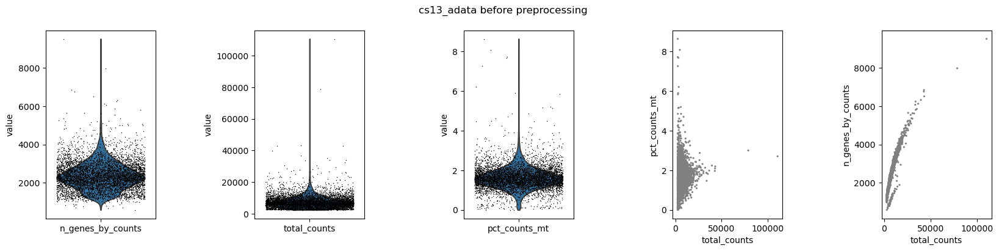

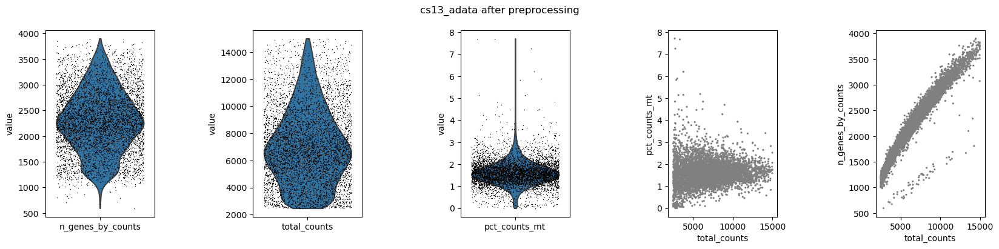

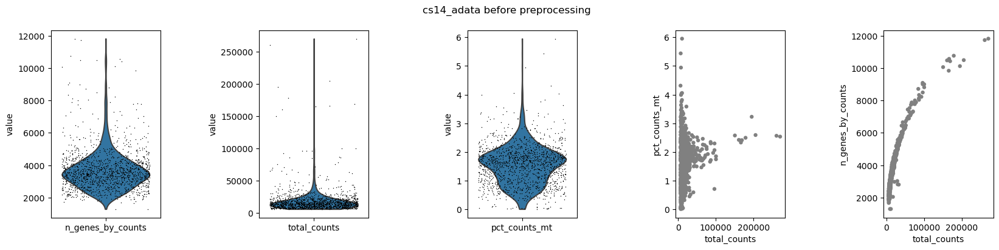

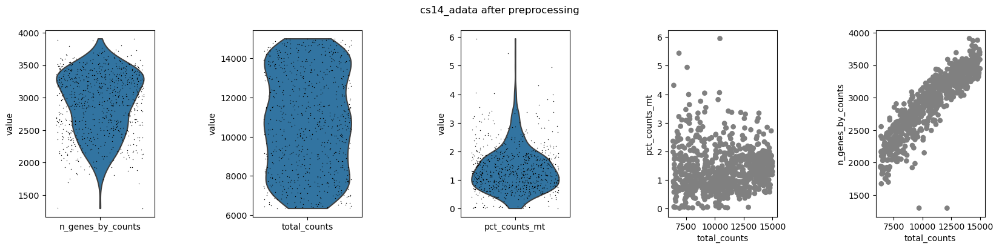

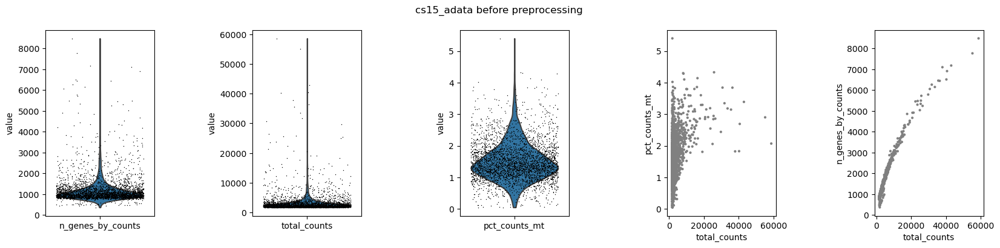

...

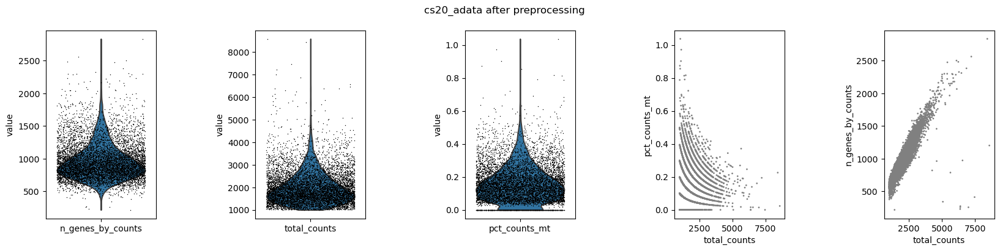

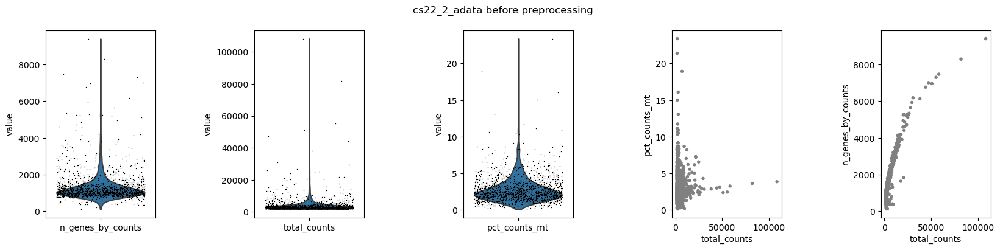

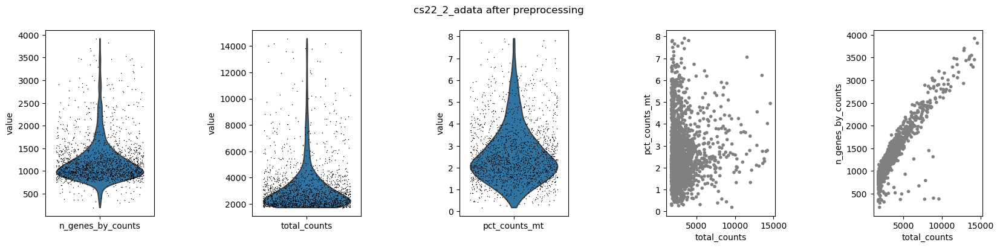

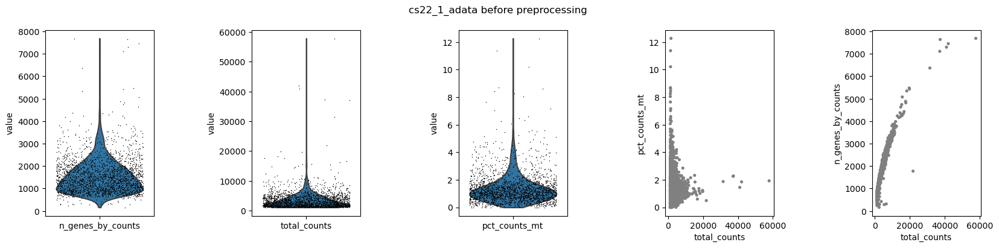

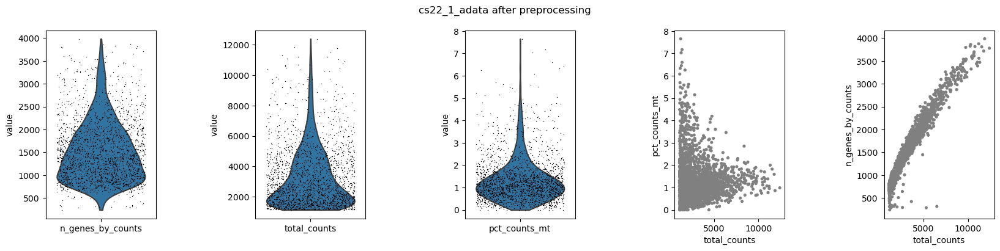

In [7]:
import matplotlib.pyplot as plt

counter = 0
for adata in adata_list:
    
    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5,  figsize=(20,4), gridspec_kw={'wspace':0.9})
    fig.suptitle(adata_names[counter] + ' before preprocessing')
    ax1_dict = sc.pl.violin(adata, ['n_genes_by_counts'], jitter=0.4, show=False, ax = ax1) 
    ax2_dict = sc.pl.violin(adata, ['total_counts'], jitter=0.4, show=False, ax = ax2)
    ax3_dict = sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, show=False, ax = ax3)    
    ax4_dict = sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', show=False, ax=ax4)
    ax5_dict = sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', show=False, ax=ax5)


    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_cells(adata, max_genes=4000)
    sc.pp.filter_cells(adata, min_counts=1000)
    sc.pp.filter_cells(adata, max_counts=15000)
    adata = adata[adata.obs.pct_counts_mt < 8, :]
           
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5,  figsize=(20,4), gridspec_kw={'wspace':0.9})
    fig.suptitle(adata_names[counter] + ' after preprocessing')
    ax1_dict = sc.pl.violin(adata, ['n_genes_by_counts'], jitter=0.4, show=False, ax = ax1) 
    ax2_dict = sc.pl.violin(adata, ['total_counts'], jitter=0.4, show=False, ax = ax2)
    ax3_dict = sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, show=False, ax = ax3)    
    ax4_dict = sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', show=False, ax=ax4)
    ax5_dict = sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', show=False, ax=ax5)
    counter += 1
    
      

#, min_counts=1000, max_counts=15000, , max_cells=4000

In [8]:
print(cs13_adata)
print(cs14_adata)
print(cs15_adata)
print(cs20_adata)
print(cs22_2_adata)
print(cs22_1_adata)

AnnData object with n_obs × n_vars = 5751 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
AnnData object with n_obs × n_vars = 761 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
AnnData object with n_obs × n_vars = 3320 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
AnnData object with n_obs × n_vars = 7795 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_

In [9]:
cs13_adata.layers["counts"] = cs13_adata.X.copy()
cs14_adata.layers["counts"] = cs14_adata.X.copy()
cs15_adata.layers["counts"] = cs15_adata.X.copy()
cs20_adata.layers["counts"] = cs20_adata.X.copy()
cs22_2_adata.layers["counts"] = cs22_2_adata.X.copy()
cs22_1_adata.layers["counts"] = cs22_1_adata.X.copy()

In [10]:

#Normalize adata 
#Normalize or not?
sc.pp.normalize_total(cs13_adata, target_sum=1e4)
sc.pp.normalize_total(cs14_adata, target_sum=1e4)
sc.pp.normalize_total(cs15_adata, target_sum=1e4)
sc.pp.normalize_total(cs20_adata, target_sum=1e4)
sc.pp.normalize_total(cs22_2_adata, target_sum=1e4)
sc.pp.normalize_total(cs22_1_adata, target_sum=1e4)

sc.pp.log1p(cs13_adata)
sc.pp.log1p(cs14_adata)
sc.pp.log1p(cs15_adata)
sc.pp.log1p(cs20_adata)
sc.pp.log1p(cs22_2_adata)
sc.pp.log1p(cs22_1_adata)


In [11]:
sc.tl.pca(cs13_adata)
sc.tl.pca(cs14_adata)
sc.tl.pca(cs15_adata)
sc.tl.pca(cs20_adata)
sc.tl.pca(cs22_2_adata)
sc.tl.pca(cs22_1_adata)

In [12]:
sc.pp.neighbors(cs13_adata)
sc.pp.neighbors(cs14_adata)
sc.pp.neighbors(cs15_adata)
sc.pp.neighbors(cs20_adata)
sc.pp.neighbors(cs22_2_adata)
sc.pp.neighbors(cs22_1_adata)


In [13]:
sc.tl.umap(cs13_adata)
sc.tl.umap(cs14_adata)
sc.tl.umap(cs15_adata)
sc.tl.umap(cs20_adata)
sc.tl.umap(cs22_2_adata)
sc.tl.umap(cs22_1_adata)

In [14]:
sc.tl.leiden(cs13_adata)
sc.tl.leiden(cs14_adata)
sc.tl.leiden(cs15_adata)
sc.tl.leiden(cs20_adata)
sc.tl.leiden(cs22_2_adata)
sc.tl.leiden(cs22_1_adata)

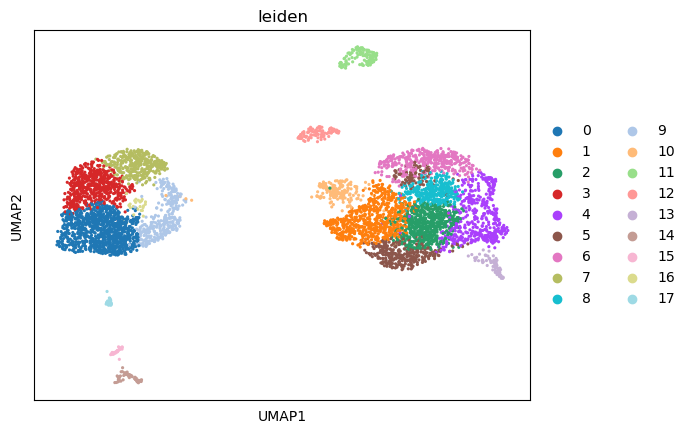

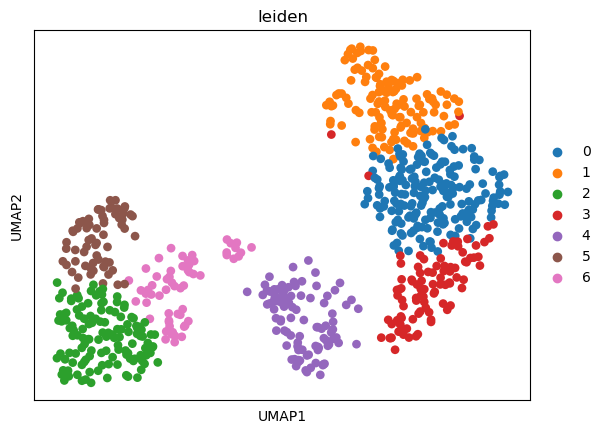

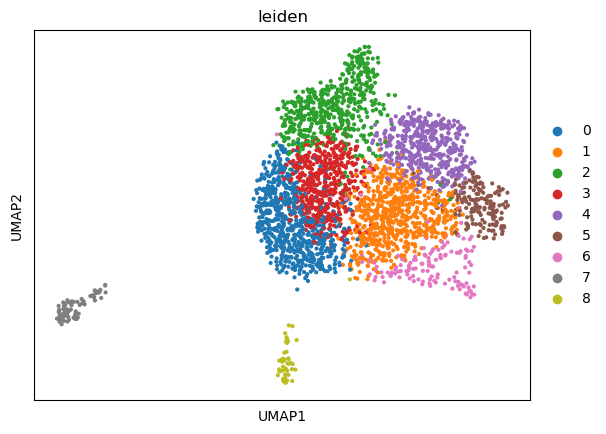

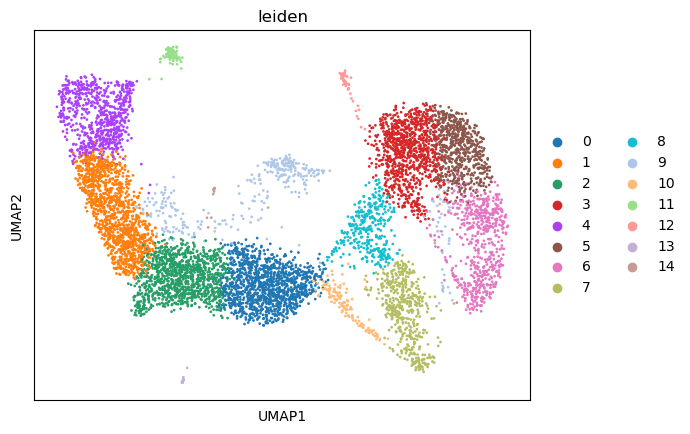

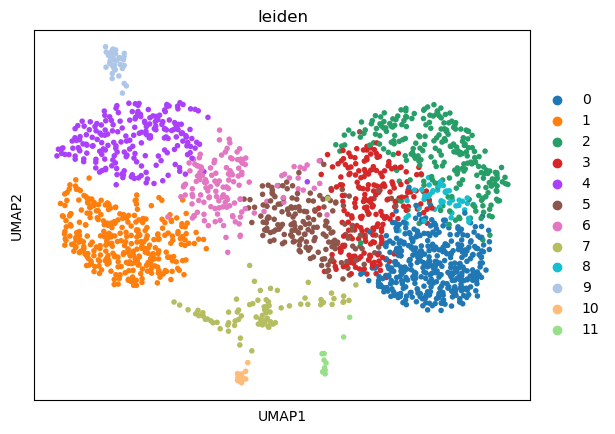

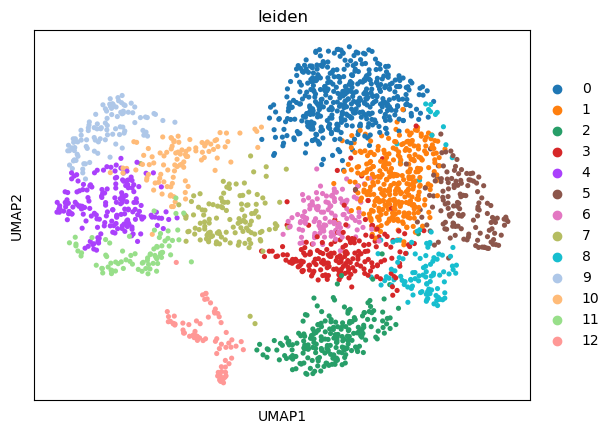

In [15]:
sc.pl.umap(cs13_adata, color="leiden")
sc.pl.umap(cs14_adata,  color="leiden")
sc.pl.umap(cs15_adata, color="leiden")
sc.pl.umap(cs20_adata, color="leiden")
sc.pl.umap(cs22_2_adata, color="leiden")
sc.pl.umap(cs22_1_adata, color="leiden")

Astrocyte, Blood, dividing progenitor, endothelial, ependymal, microglia, neurons, oligodendrocyte, pericytes, radial glia, tanycytes, VLMC

Top transcription factor: 
Astrocyte: NPAS3, NR2F1
Blood: KLF1, HSF1, NR1H2
Dividing Progenitor: CENPA, PIN1, NFYB, THYN1, NR2F1
Endothelial: PIN1, EPAS1, KLF4
Ependymal: FOXJ1, RFX3, RFX3, NR2F1, NPAS3
Microglia: MAF, BHLHE41
Neuron: MYTIL, NEUROD6, CSRNP3, BCL11A
Oligodendrocyte: OLIG1, SOX6, OLIG2, NKX2-2, SOX10
Pericyte: EPAS1, EBF1, NR2F1
Radial glia: PIN1, EMX2, TFDP2, THYN1
Tanycyte: NPAS3, THYN1, DDIT3, ATF3, 
VLMC: PIN1, NFYB, TFDP2, THYN1, ALX1, NR2F1




CS13 (GW4): VLMC, Radial Glia, 



In [33]:
marker_genes = ["PIN1", "NFYB", "ALX1", "NR2F1", "NPAS3", "THYN1", "DDIT3", "ATF3", "EMX2", "TFDP2",
"EPAS1", "EBF1", "OLIG1", "SOX6", "OLIG2", "NKX2-2", "SOX10", "MYT1L", "NEUROD6", "CSRNP3", "BCL11A",
"MAF", "BHLHE41", "FOXJ1", "RFX3", "KLF4", "CENPA",
"KLF1", "HSF1", "NR1H2"]


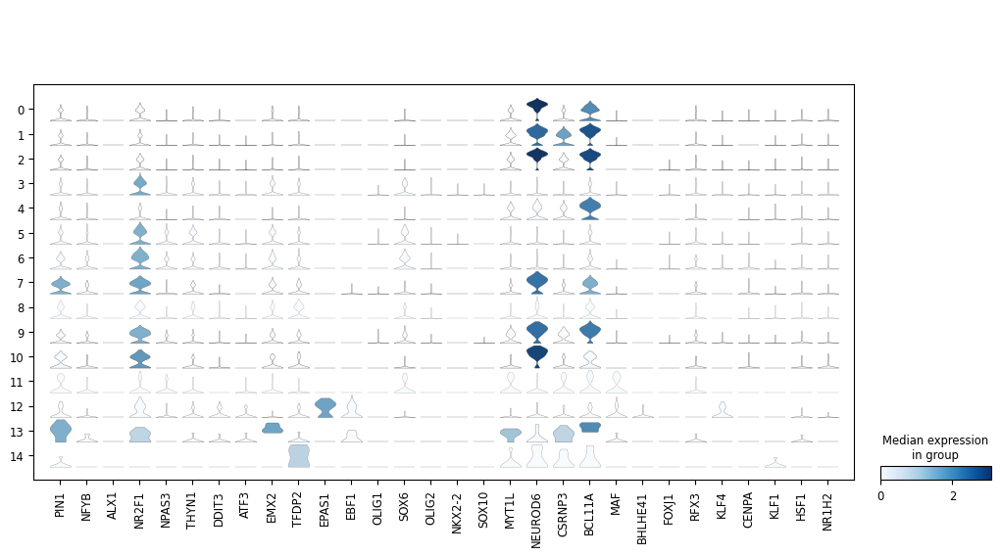

In [44]:
sc.pl.stacked_violin(cs20_adata, marker_genes, groupby='leiden')

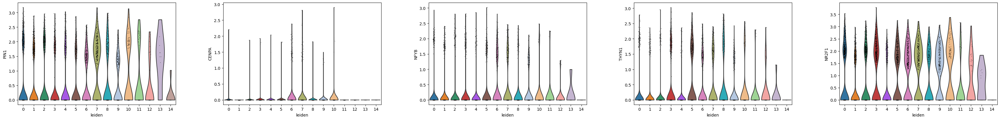

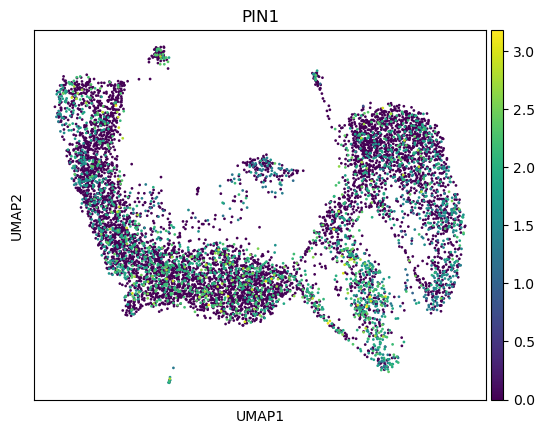

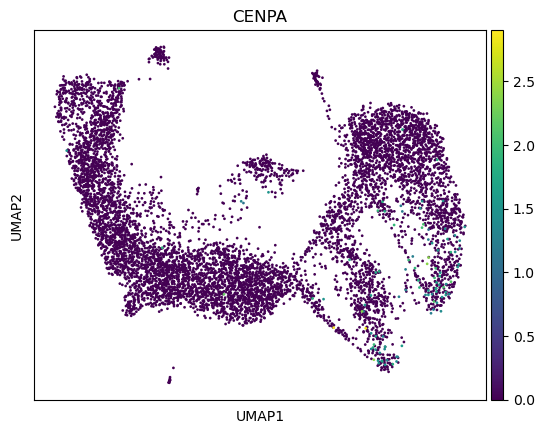

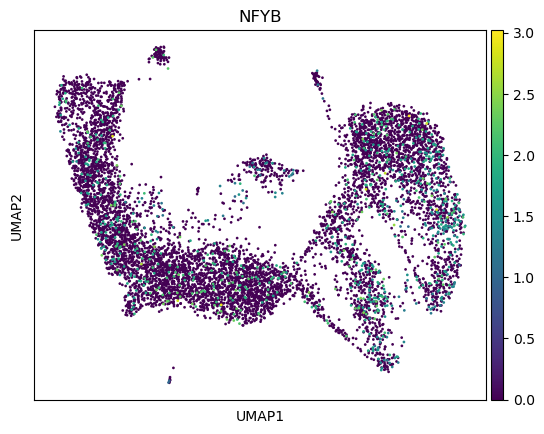

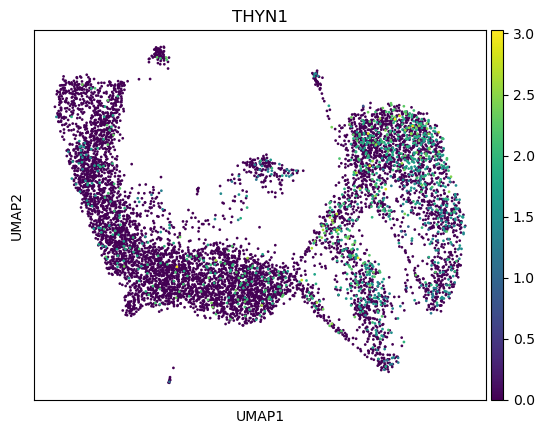

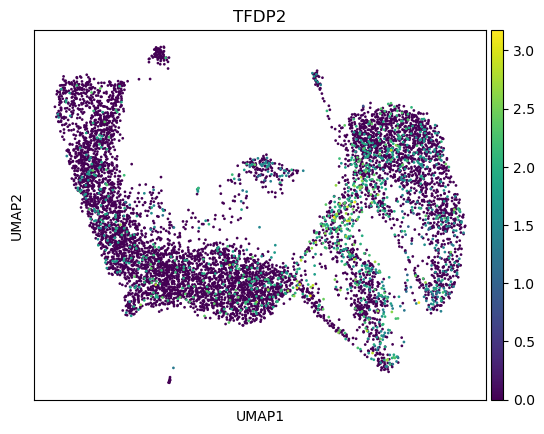

In [46]:
sc.pl.violin(cs20_adata, ['PIN1', "CENPA", "NFYB", "THYN1", "NR2F1"], groupby='leiden')
sc.pl.umap(cs20_adata, color="PIN1")
sc.pl.umap(cs20_adata, color="CENPA")
sc.pl.umap(cs20_adata, color="NFYB")
sc.pl.umap(cs20_adata, color="THYN1")
sc.pl.umap(cs20_adata, color="TFDP2")


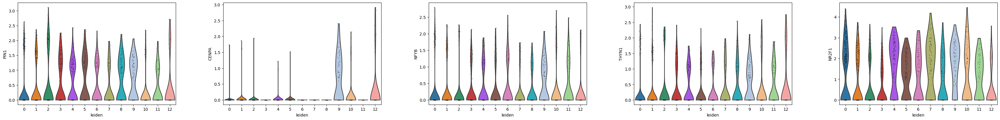

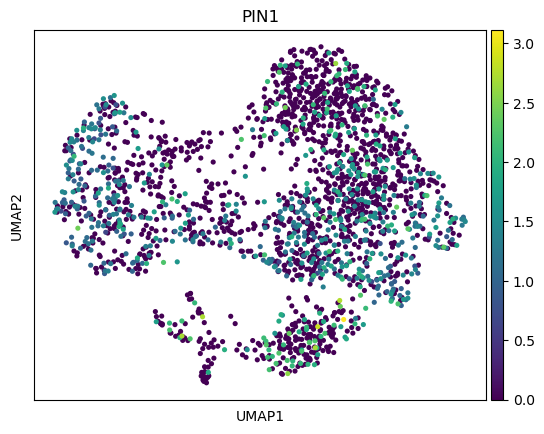

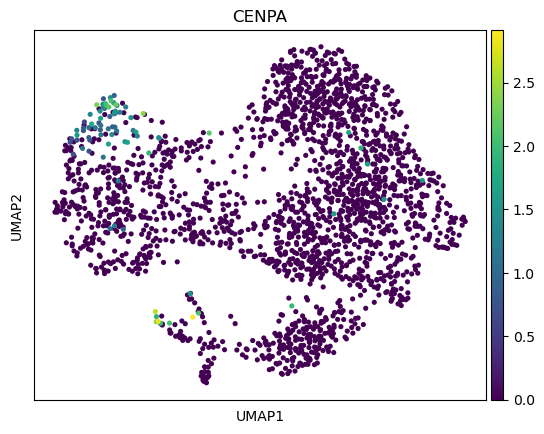

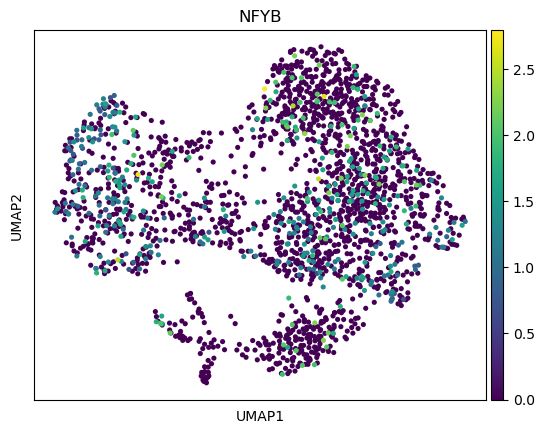

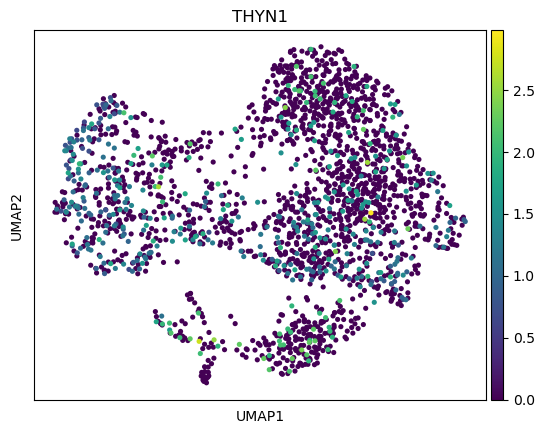

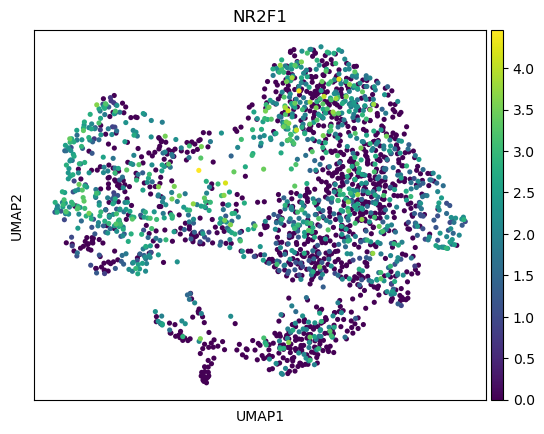

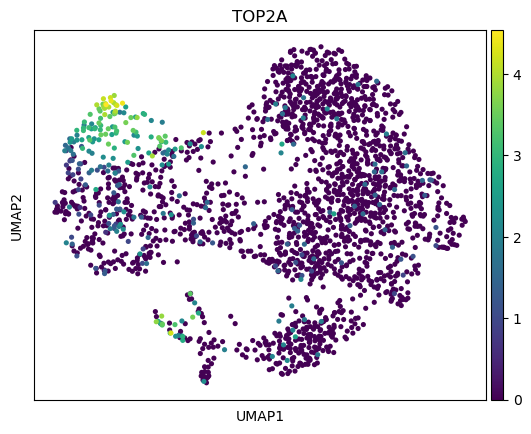

In [95]:
sc.pl.violin(cs22_1_adata, ['PIN1', "CENPA", "NFYB", "THYN1", "NR2F1"], groupby='leiden')
sc.pl.umap(cs22_1_adata, color="PIN1")
sc.pl.umap(cs22_1_adata, color="CENPA")
sc.pl.umap(cs22_1_adata, color="NFYB")
sc.pl.umap(cs22_1_adata, color="THYN1")
sc.pl.umap(cs22_1_adata, color="NR2F1")
sc.pl.umap(cs22_1_adata, color="TOP2A")






In [92]:
dedf = sc.get.rank_genes_groups_df(cs22_1_adata, group="9")

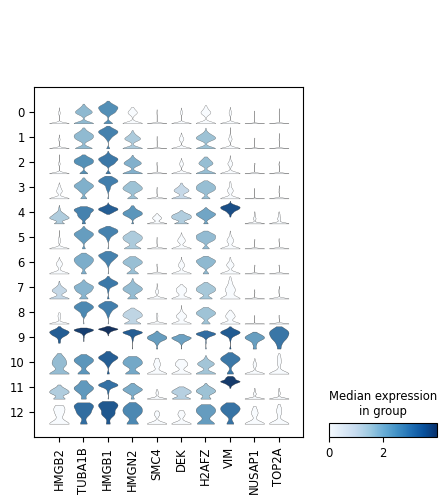

In [94]:
temp = ['HMGB2',
 'TUBA1B',
 'HMGB1',
 'HMGN2',
 'SMC4',
 'DEK',
 'H2AFZ',
 'VIM',
 'NUSAP1',
 'TOP2A']
sc.pl.stacked_violin(cs22_1_adata, temp, groupby='leiden')


In [70]:
cs22_1_adata

AnnData object with n_obs × n_vars = 2175 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [ ]:
sc.tl.rank_genes_groups(cs22_1_adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(cs22_1_adata, n_genes=20, sharey=False)



In [ ]:
sc.tl.rank_genes_groups(cs22_1_adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(cs14_adata, n_genes=20, sharey=False)

In [ ]:
#sc.pl.violin(cs14_adata, ['EOMES'], groupby='leiden')
sc.pl.violin(cs14_adata, ['OTP', "NPY"], groupby='leiden')

In [3]:
# Read trimester 2 data
#GW18_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/GW18_hypothalamus", var_names="gene_symbols")
#GW19_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/GW19_hypothalamus", var_names="gene_symbols")
#GW20_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/GW20_hypothalamus", var_names="gene_symbols")
#GW22_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/GW22T_hypo1", var_names="gene_symbols")
GW25_adata = sc.read_10x_mtx("/media/ernohanninen/TOSHIBA/masterproject/Analysis_Herb_Ament_Human_Development_Hypothalamus_Counts/Raw_data_Herb_Ament_Human_Development_Hypothalamus_Counts/data/GW25_3V_hypo", var_names="gene_symbols")

In [4]:
"""GW18_adata.var_names_make_unique()
GW19_adata.var_names_make_unique()
GW20_adata.var_names_make_unique()
GW22_adata.var_names_make_unique()"""#
GW25_adata.var_names_make_unique()

In [5]:
GW25_adata

AnnData object with n_obs × n_vars = 8437 × 33694
    var: 'gene_ids'

In [6]:
#adata_list = [GW18_adata, GW19_adata, GW20_adata, GW22_adata, GW25_adata]
#adata_names = ["GW18_adata", "GW19_adata", "GW20_adata", "GW22_adata", "GW25_adata"]
adata_list = [GW25_adata]
adata_names = ["GW25_adata"]

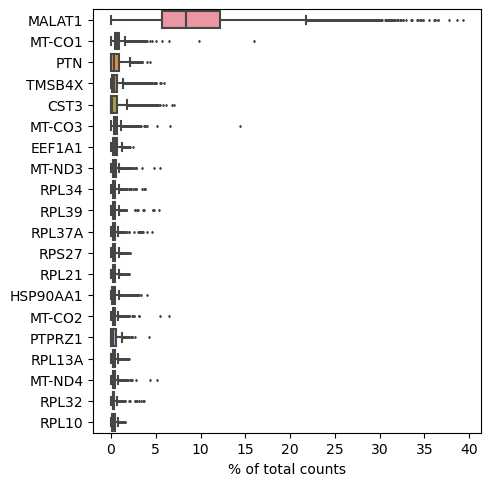

In [7]:
sc.pl.highest_expr_genes(GW25_adata, n_top=20)

All samples were quality filtered to include cells with the number of detected genes between 200 & 4000, a total UMI between 1,000 and 15,000 and a maximum 20 percent of reads mapping to mitochondrial genes. Doublets were detected using scDblFinder and discarded from the analysis.


print(GW18_adata)
print(GW19_adata)
print(GW20_adata)
print(GW22_adata)
print(GW25_adata)

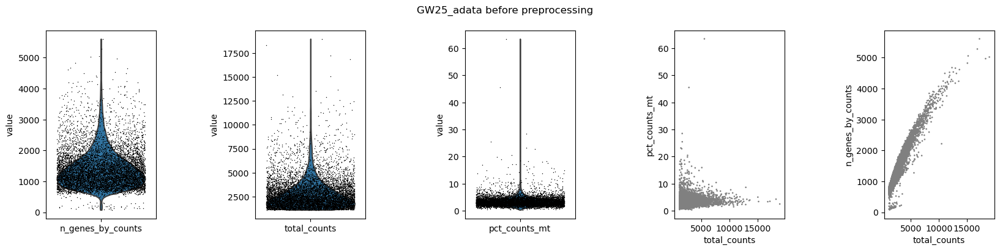

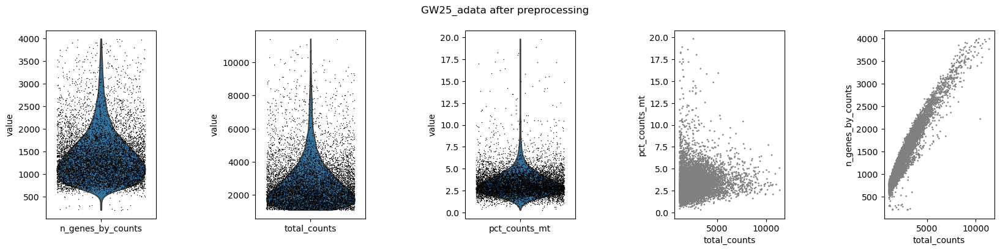

In [8]:

import matplotlib.pyplot as plt

counter = 0
for adata in adata_list:
    
    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5,  figsize=(20,4), gridspec_kw={'wspace':0.9})
    fig.suptitle(adata_names[counter] + ' before preprocessing')
    ax1_dict = sc.pl.violin(adata, ['n_genes_by_counts'], jitter=0.4, show=False, ax = ax1) 
    ax2_dict = sc.pl.violin(adata, ['total_counts'], jitter=0.4, show=False, ax = ax2)
    ax3_dict = sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, show=False, ax = ax3)    
    ax4_dict = sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', show=False, ax=ax4)
    ax5_dict = sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', show=False, ax=ax5)


    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_cells(adata, max_genes=4000)
    sc.pp.filter_cells(adata, min_counts=1000)
    sc.pp.filter_cells(adata, max_counts=15000)
    adata = adata[adata.obs["pct_counts_mt"] < 20, :]
           
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5,  figsize=(20,4), gridspec_kw={'wspace':0.9})
    fig.suptitle(adata_names[counter] + ' after preprocessing')
    ax1_dict = sc.pl.violin(adata, ['n_genes_by_counts'], jitter=0.4, show=False, ax = ax1) 
    ax2_dict = sc.pl.violin(adata, ['total_counts'], jitter=0.4, show=False, ax = ax2)
    ax3_dict = sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4, show=False, ax = ax3)    
    ax4_dict = sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', show=False, ax=ax4)
    ax5_dict = sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', show=False, ax=ax5)
    counter += 1
    

In [9]:
GW25_adata

AnnData object with n_obs × n_vars = 8374 × 33694
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [14]:
import numpy as np
malat1 = GW25_adata.var_names.str.startswith('MALAT1')
# we need to redefine the mito_genes since they were first 
# calculated on the full object before removing low expressed genes.
mito_genes = GW25_adata.var_names.str.startswith('*')

remove = np.add(malat1, mito_genes)
keep = np.invert(remove)

GW25_adata = GW25_adata[:,keep]

print(GW25_adata.n_obs, GW25_adata.n_vars)

8374 33693


/home/ernohanninen/miniconda3/envs/PYenv/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


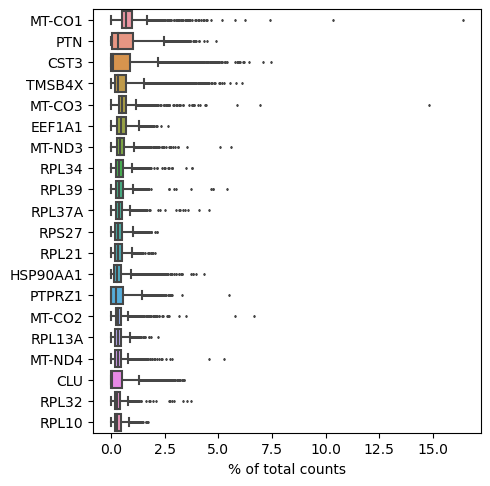

In [15]:
sc.pl.highest_expr_genes(GW25_adata, n_top=20)

In [213]:
import scrublet 

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.33
Detected doublet rate = 3.8%
Estimated detectable doublet fraction = 49.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 7.6%
Elapsed time: 17.5 seconds


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

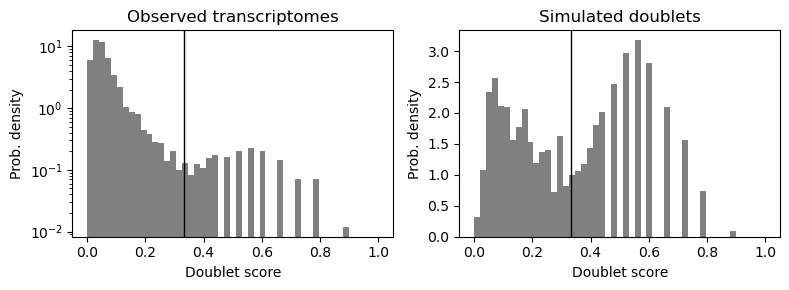

In [214]:
import scrublet as scr
scrub = scr.Scrublet(GW25_adata.X)
GW25_adata.obs['doublet_scores'], GW25_adata.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

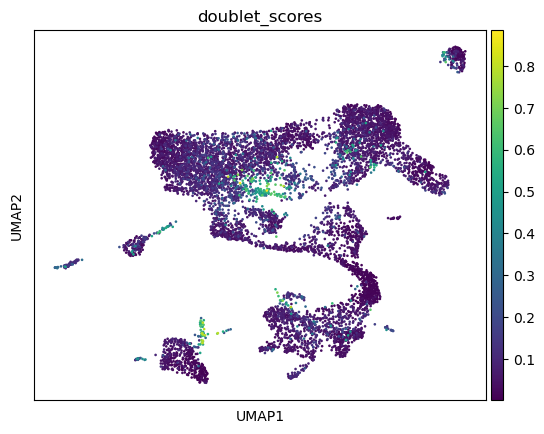

In [232]:
sc.pl.umap(GW25_adata, color='doublet_scores')


In [16]:
#adata_list = [GW18_adata, GW19_adata, GW20_adata, GW22_adata, GW25_adata]
adata_list = [GW25_adata]


In [17]:
"""GW18_adata.layers["counts"] = GW18_adata.X.copy()
GW19_adata.layers["counts"] = GW19_adata.X.copy()
GW20_adata.layers["counts"] = GW20_adata.X.copy()
GW22_adata.layers["counts"] = GW22_adata.X.copy()"""
GW25_adata.layers["counts"] = GW25_adata.X.copy()

In [18]:
#Normalize adata 
#Normalize or not?
"""sc.pp.normalize_total(GW18_adata, target_sum=1e4)
sc.pp.normalize_total(GW19_adata, target_sum=1e4)
sc.pp.normalize_total(GW20_adata, target_sum=1e4)
sc.pp.normalize_total(GW22_adata, target_sum=1e4)"""
sc.pp.normalize_total(GW25_adata, target_sum=1e4)

"""sc.pp.log1p(GW18_adata)
sc.pp.log1p(GW19_adata)
sc.pp.log1p(GW20_adata)
sc.pp.log1p(GW22_adata)"""
sc.pp.log1p(GW25_adata)

In [19]:
"""sc.tl.pca(GW18_adata)
sc.tl.pca(GW19_adata)
sc.tl.pca(GW20_adata)
sc.tl.pca(GW22_adata)"""
sc.tl.pca(GW25_adata)

In [20]:
"""sc.pp.neighbors(GW18_adata)
sc.pp.neighbors(GW19_adata)
sc.pp.neighbors(GW20_adata)
sc.pp.neighbors(GW22_adata)"""
sc.pp.neighbors(GW25_adata)

In [21]:
"""sc.tl.umap(GW18_adata)
sc.tl.umap(GW19_adata)
sc.tl.umap(GW20_adata)
sc.tl.umap(GW22_adata)"""
sc.tl.umap(GW25_adata)

In [22]:
"""sc.tl.leiden(GW18_adata)
sc.tl.leiden(GW19_adata)
sc.tl.leiden(GW20_adata)
sc.tl.leiden(GW22_adata)"""
sc.tl.leiden(GW25_adata)

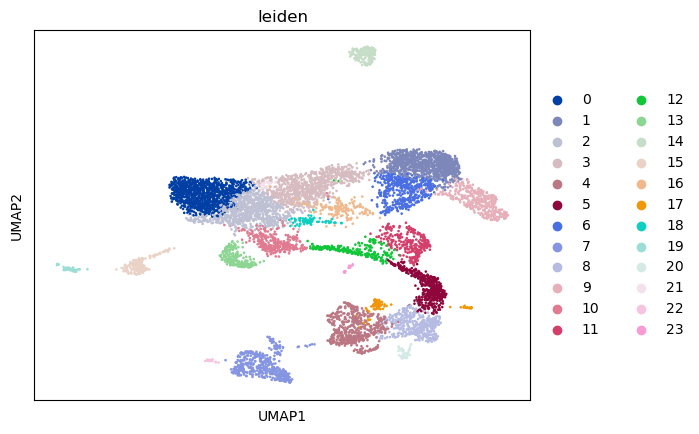

In [23]:
"""sc.pl.umap(GW18_adata, color="leiden")
sc.pl.umap(GW19_adata,  color="leiden")
sc.pl.umap(GW20_adata, color="leiden")
sc.pl.umap(GW22_adata, color="leiden")"""
sc.pl.umap(GW25_adata, color="leiden")

In [24]:
marker_genes = ["PIN1", "NFYB", "ALX1", "NR2F1", "NPAS3", "THYN1", "DDIT3", "ATF3", "EMX2", "TFDP2",
"EPAS1", "EBF1", "OLIG1", "SOX6", "OLIG2", "NKX2-2", "SOX10", "MYT1L", "NEUROD6", "CSRNP3", "BCL11A",
"MAF", "BHLHE41", "FOXJ1", "RFX3", "KLF4", "CENPA",
"KLF1", "HSF1", "NR1H2"]

In [ ]:
sc.pl.stacked_violin(GW22_adata, marker_genes, groupby='leiden')


In [ ]:
sc.pl.umap(GW22_adata, color=["EPAS1","BHLHE41"])
sc.pl.umap(GW22_adata, color=["KLF4","EBF1"])




In [ ]:
dedf = sc.get.rank_genes_groups_df(GW25_adata, group="21")["names"].to_list()[400:500]
print(dedf)

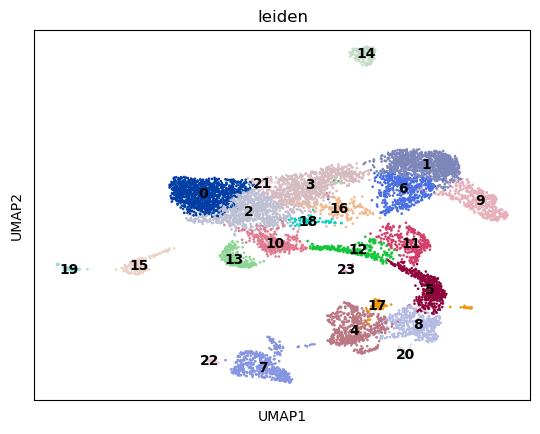

In [25]:
sc.pl.umap(GW25_adata, color="leiden", legend_loc="on data")

In [ ]:
sc.pl.stacked_violin(GW25_adata, marker_genes, groupby='leiden')


In [ ]:
sc.pl.stacked_violin(GW25_adata, "P2RY12", groupby='leiden')


In [ ]:
sc.pl.dotplot(GW25_adata, marker_genes, groupby='leiden')

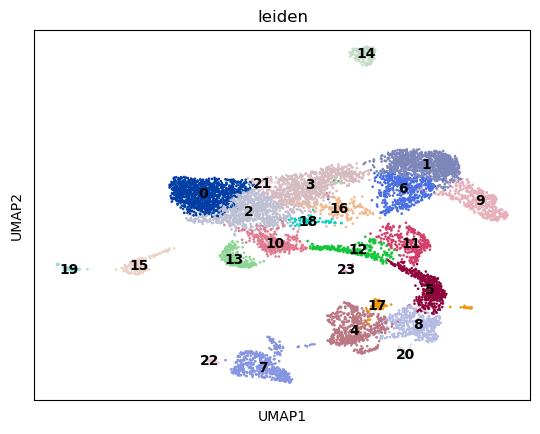

In [26]:
sc.pl.umap(GW25_adata, color="leiden", legend_loc="on data")

Based on the marker genes I've tested below I would classify the clusters in a following way:
- 7: Microglia
- 0, 2, 10 and maybe 10 as well: Astrocytes
- 1, 6 and 9: Oligodendrocytes
    - Most if not all of the markers I used to identify Oligidendrocytes are required for oligodendrocyte differentiation, so what if I am mixing things up and clusters 1 and 6 are actually dividing progerenitor cells
- 15: Pericytes
- 19: Endothelial
- 14: Ependymal, however the marker genes I used to identify the ependymal cells also expresses in cluster 13 and I have no idea what that cluster could be.
- Blood cells: maybe 17
- Dividing progrenitors: I would guess that it is located in somewhere around clusters 3, 18 and 16, as these clusters expresses olig1 and olig2, required for oligodendrocyte differentiation. Clusters 18, 10, 12 might also be dividing progenitors due to the expression of VIM, NES and HES1.
- Radial glia
- Tanycyte
- Neuronal cell types
- VLMC


- Clusters 13 and 10?



Microglia:


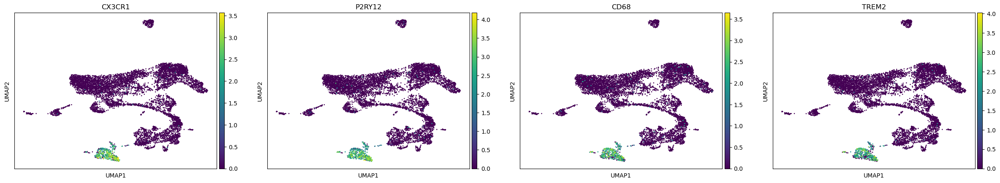

Astrocyte:


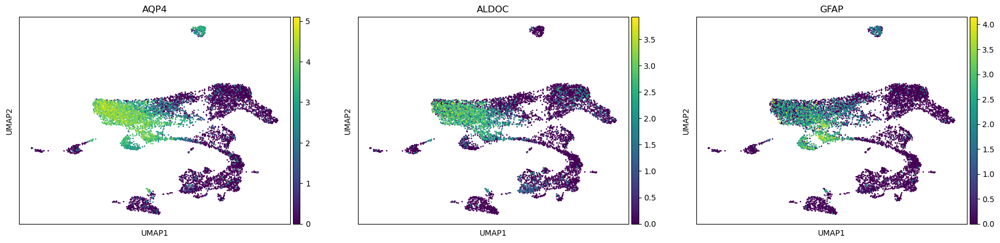

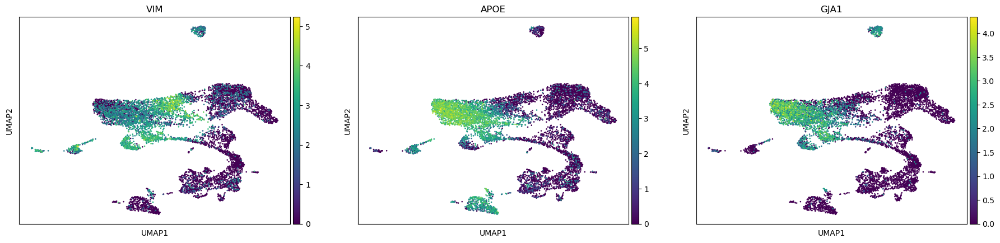

Oligodendrocyte:


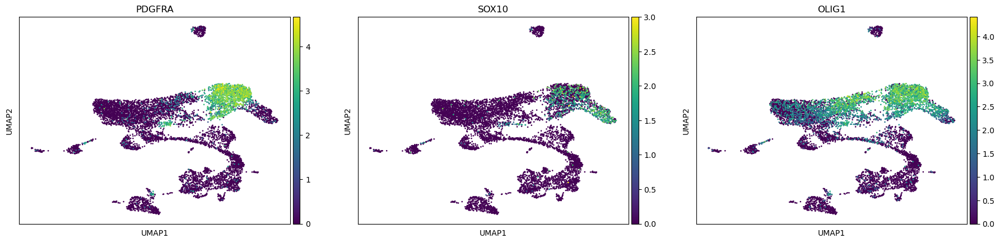

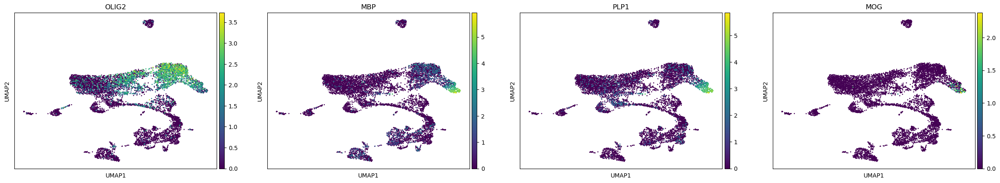

Dividing progenitor:


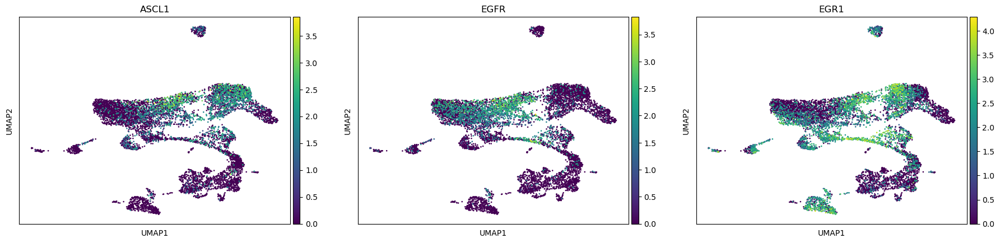

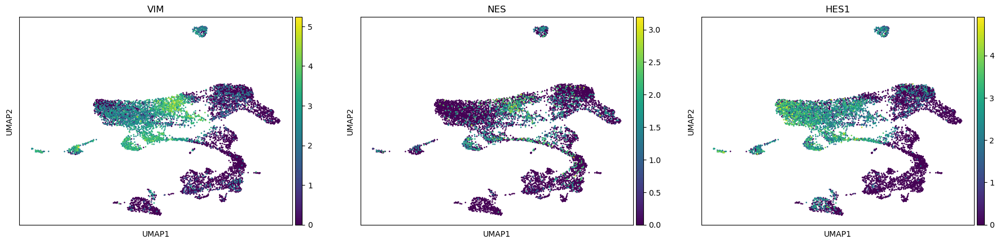

Pericyte:


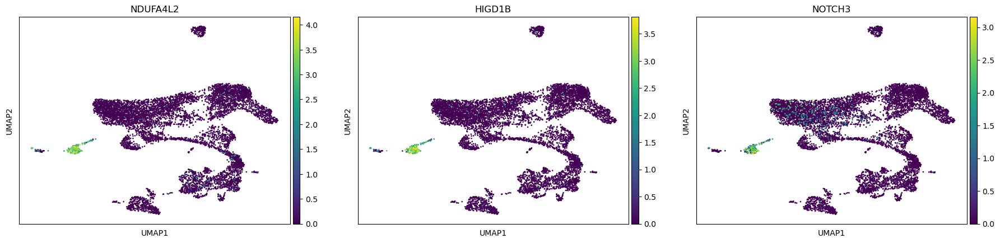

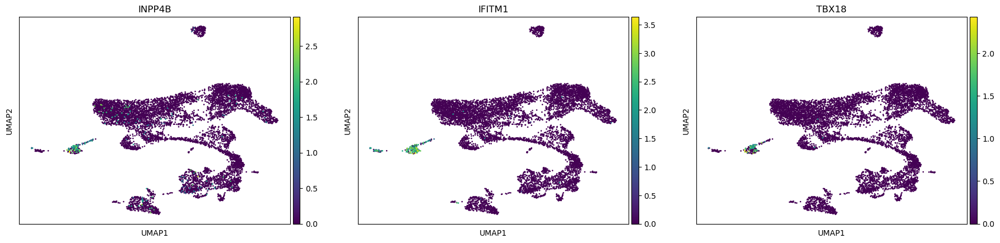

Endothelial


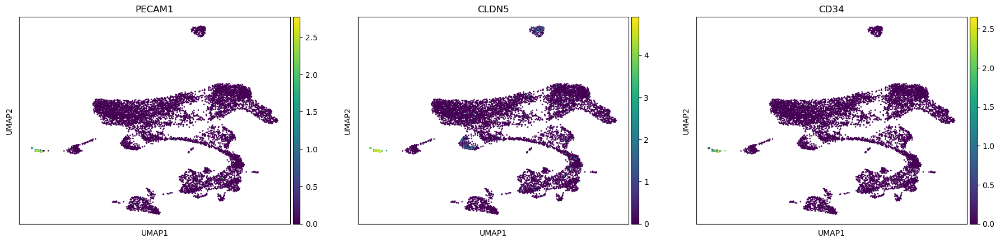

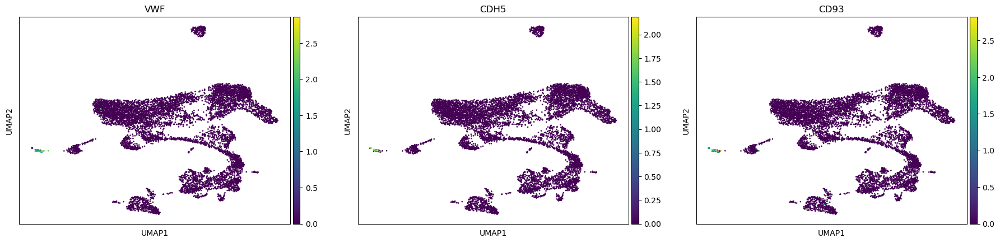

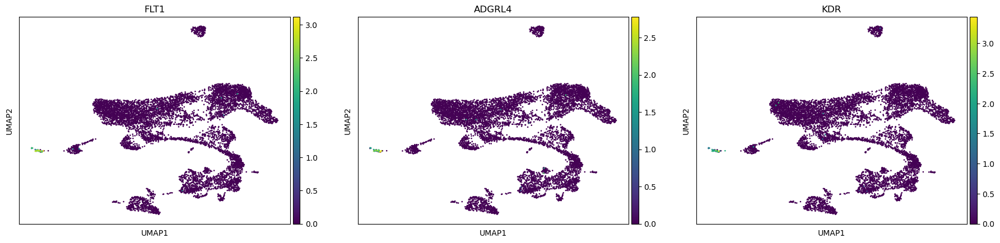

Ependymal


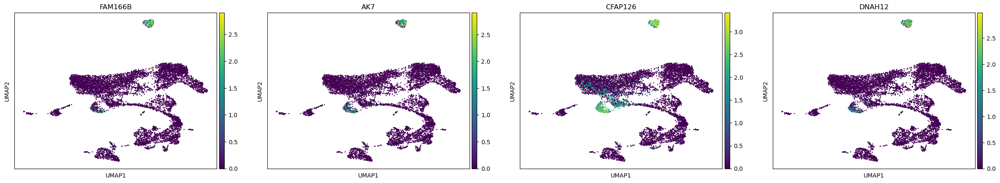

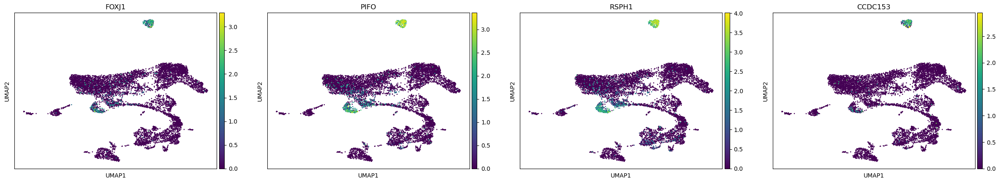

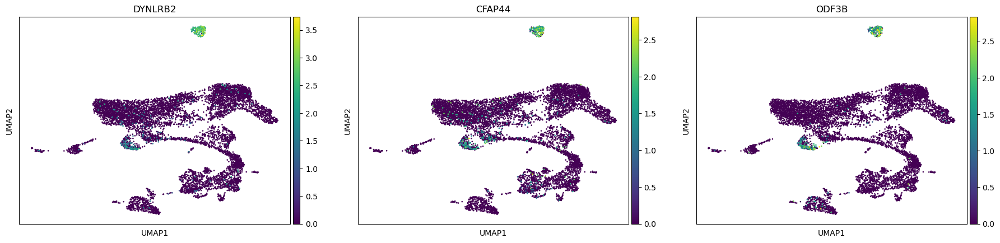

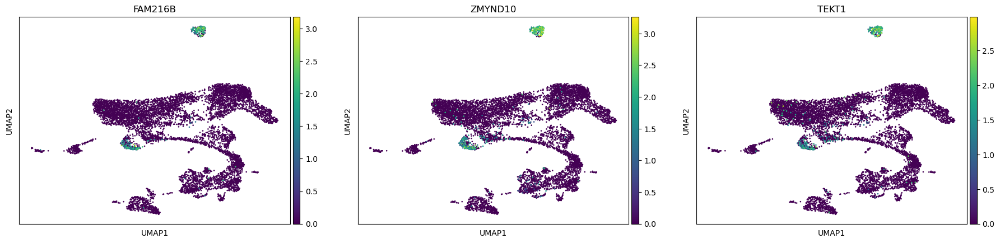

Radial glia


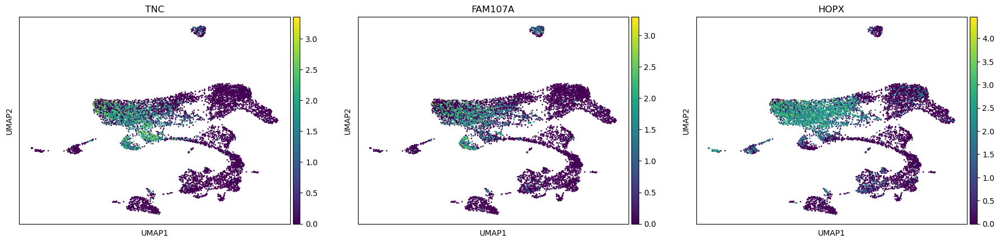

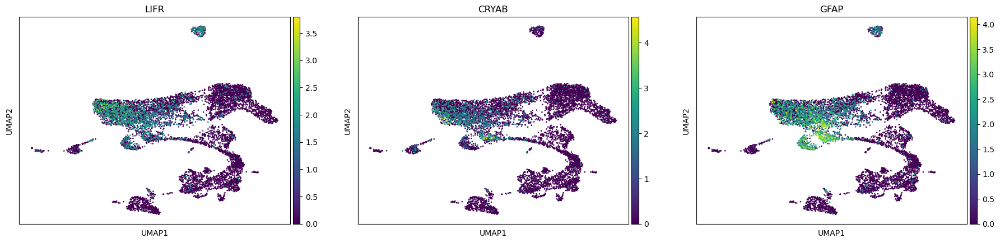

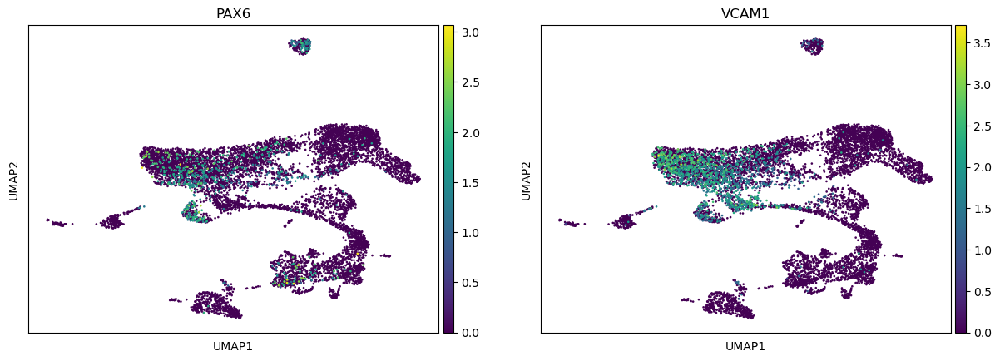

Tanycyte: (for tanycyte I tested a lot of markers these worked the best)


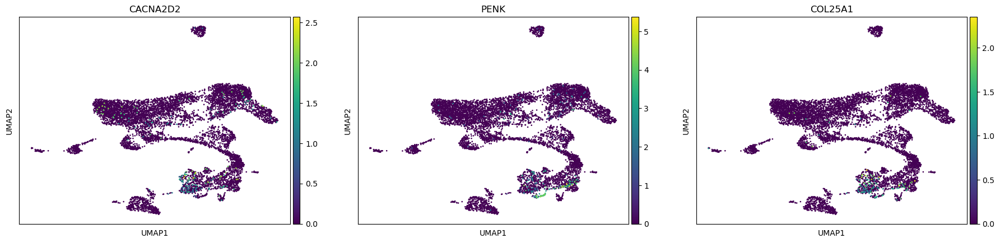

Blood cells


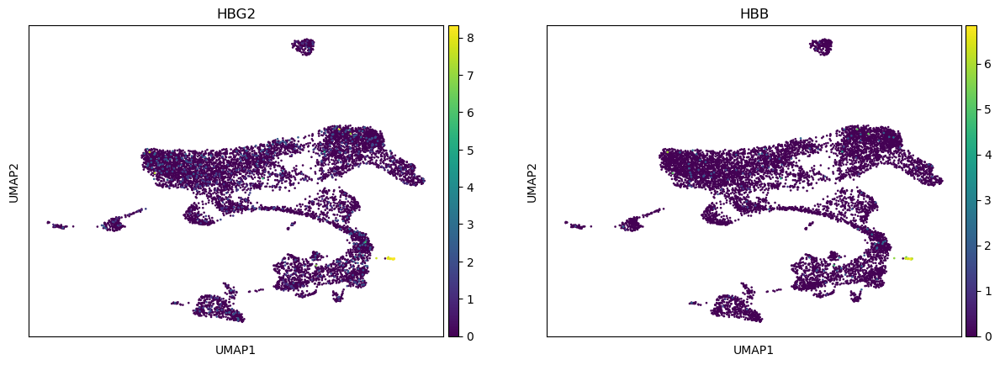

Neuronal cell types


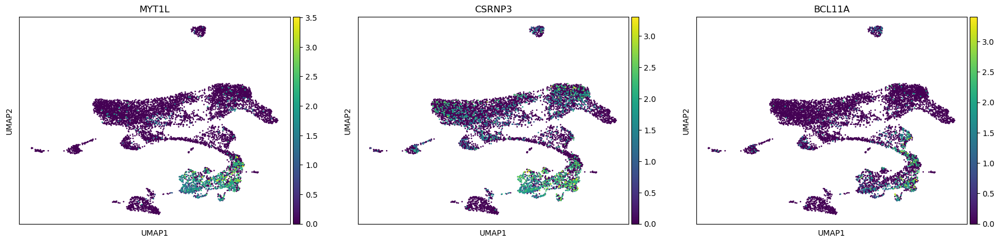

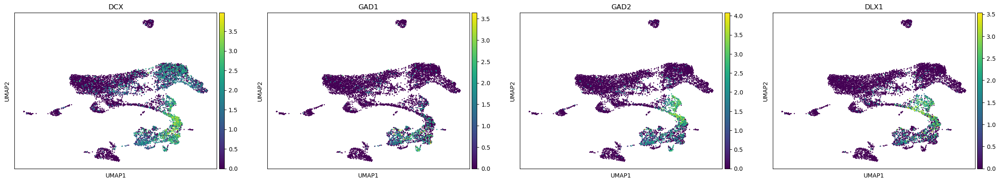

VLMC: 


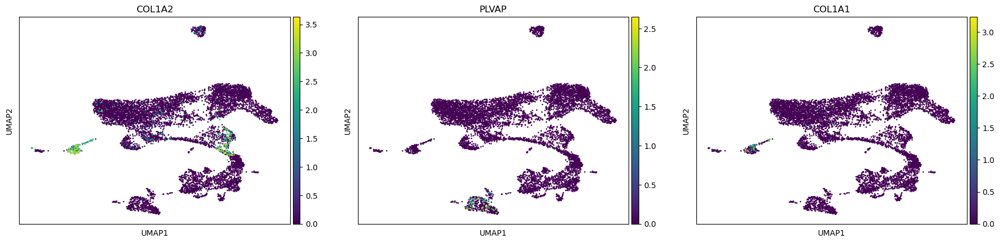

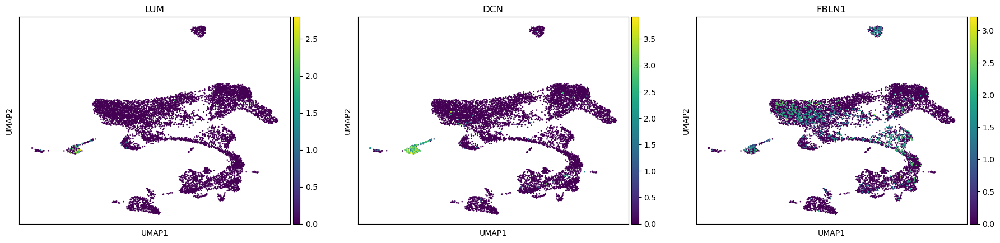

In [190]:
print("Microglia:")
sc.pl.umap(GW25_adata, color=["CX3CR1","P2RY12", "CD68", "TREM2"])

print("Astrocyte:")
sc.pl.umap(GW25_adata, color=["AQP4", "ALDOC", "GFAP"])
sc.pl.umap(GW25_adata, color=["VIM", "APOE", "GJA1"])
print("Oligodendrocyte:")
sc.pl.umap(GW25_adata, color=["PDGFRA", "SOX10", "OLIG1"])
sc.pl.umap(GW25_adata, color=["OLIG2", "MBP", "PLP1", "MOG"])

print("Dividing progenitor:")
sc.pl.umap(GW25_adata, color=["ASCL1", "EGFR", "EGR1"])
sc.pl.umap(GW25_adata, color=["VIM","NES", "HES1"])
print("Pericyte:")
sc.pl.umap(GW25_adata, color=["NDUFA4L2", "HIGD1B", "NOTCH3"])
sc.pl.umap(GW25_adata, color=["INPP4B", "IFITM1", "TBX18"])
print("Endothelial")
sc.pl.umap(GW25_adata, color=["PECAM1", "CLDN5", "CD34"])
sc.pl.umap(GW25_adata, color=["VWF", "CDH5", "CD93"])
sc.pl.umap(GW25_adata, color=["FLT1", "ADGRL4", "KDR"])
print("Ependymal")
sc.pl.umap(GW25_adata, color=["FAM166B", "AK7", "CFAP126", "DNAH12"])
sc.pl.umap(GW25_adata, color=["FOXJ1", "PIFO", "RSPH1", "CCDC153"])
sc.pl.umap(GW25_adata, color=["DYNLRB2", "CFAP44","ODF3B"])
sc.pl.umap(GW25_adata, color=["FAM216B", "ZMYND10", "TEKT1"])
print("Radial glia")
sc.pl.umap(GW25_adata, color=["TNC", "FAM107A", "HOPX"])
sc.pl.umap(GW25_adata, color=["LIFR", "CRYAB", "GFAP"])
sc.pl.umap(GW25_adata, color=["PAX6", "VCAM1"])
print("Tanycyte: (for tanycyte I tested a lot of markers these worked the best)")
sc.pl.umap(GW25_adata, color=["CACNA2D2", "PENK", "COL25A1"])
print("Blood cells")
sc.pl.umap(GW25_adata, color=["HBG2", "HBB"])
print("Neuronal cell types")
sc.pl.umap(GW25_adata, color=["MYT1L", "CSRNP3", "BCL11A"])
sc.pl.umap(GW25_adata, color=["DCX", "GAD1", "GAD2", "DLX1"])
print("VLMC: ")
sc.pl.umap(GW25_adata, color=["COL1A2", "PLVAP", "COL1A1"])
sc.pl.umap(GW25_adata, color=["LUM", "DCN", "FBLN1"])

Microglia:


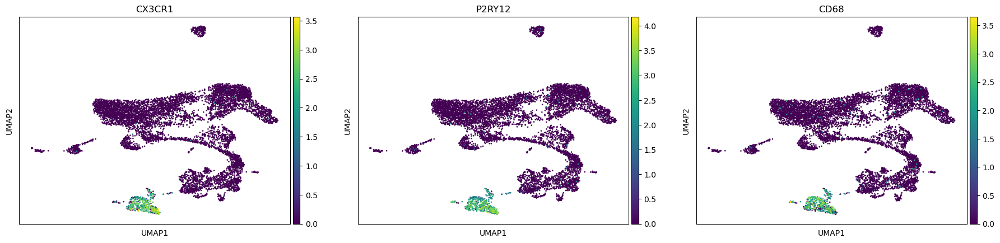

Astrocyte:


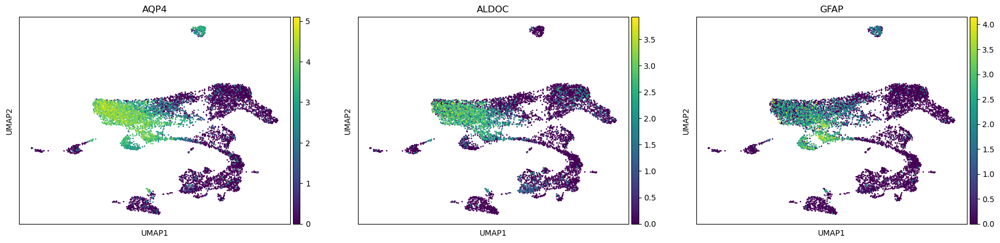

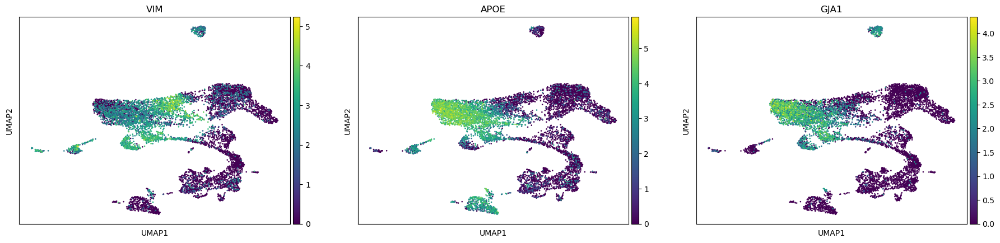

Radial glia


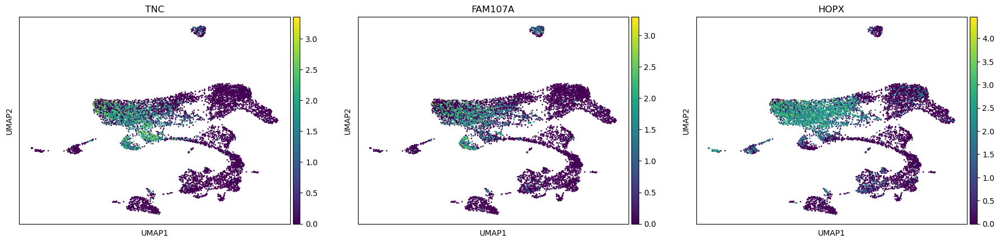

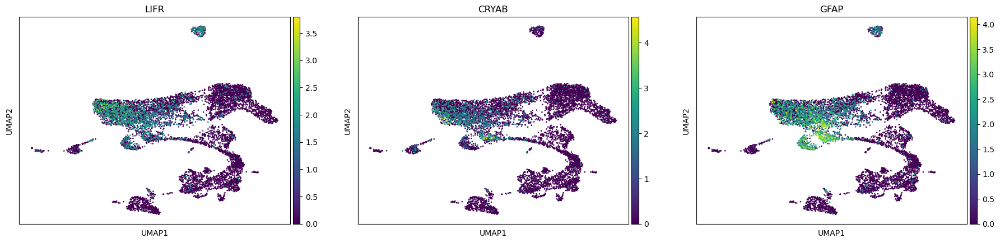

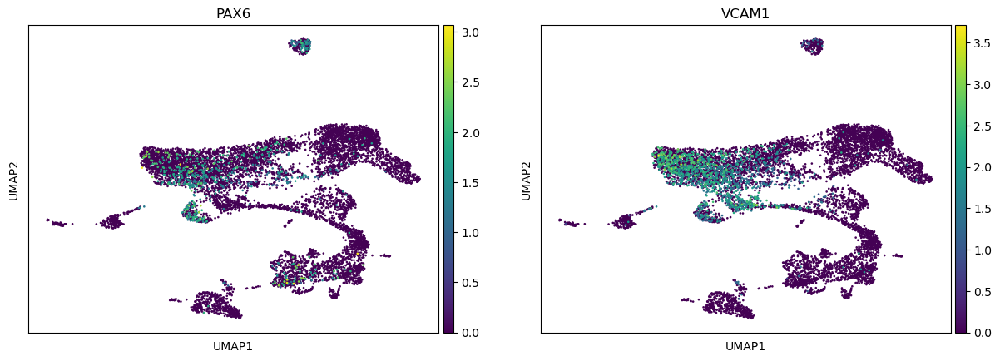

Oligodendrocyte:


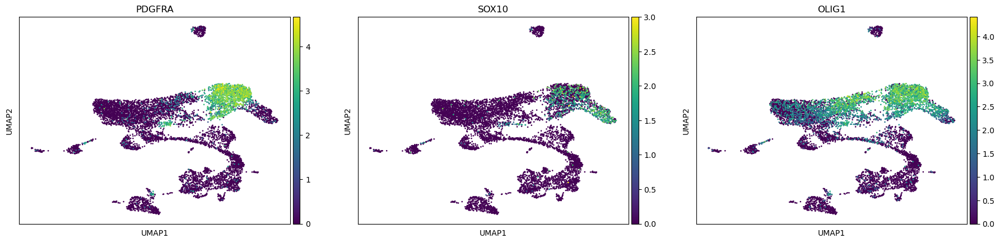

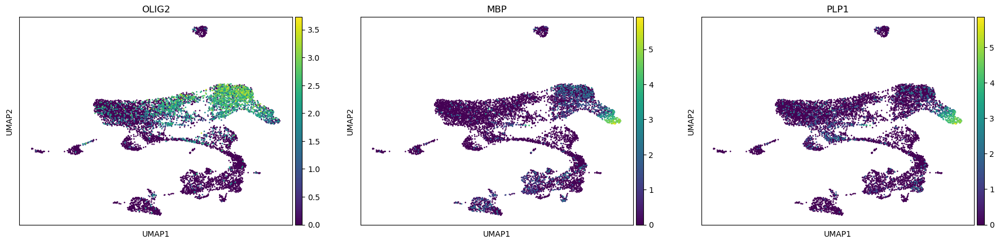

Dividing progenitor:


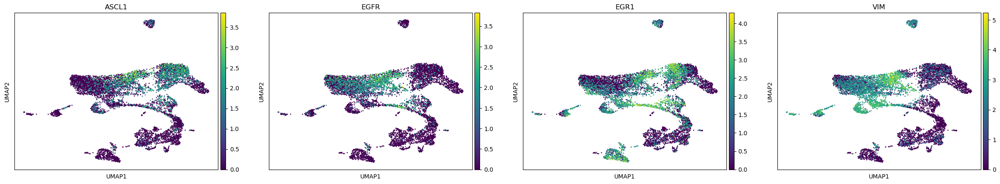

Pericyte:


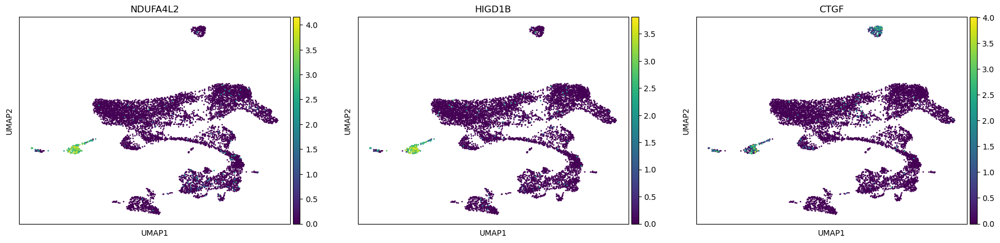

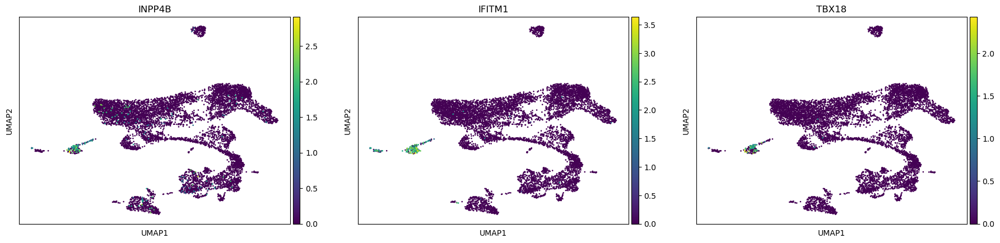

Endothelial


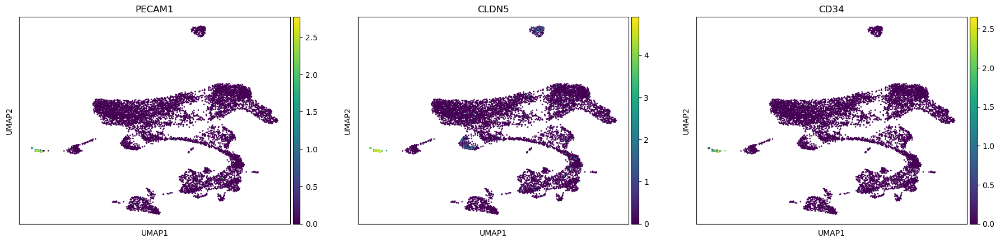

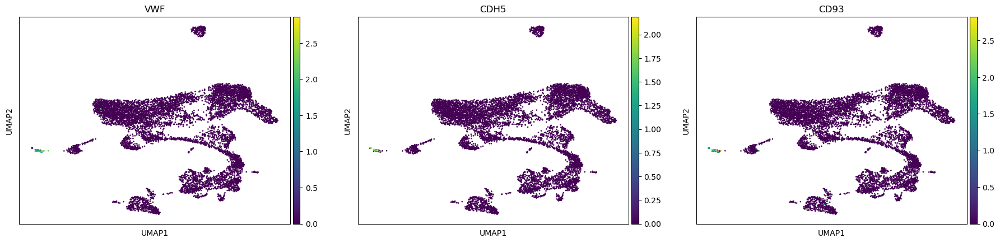

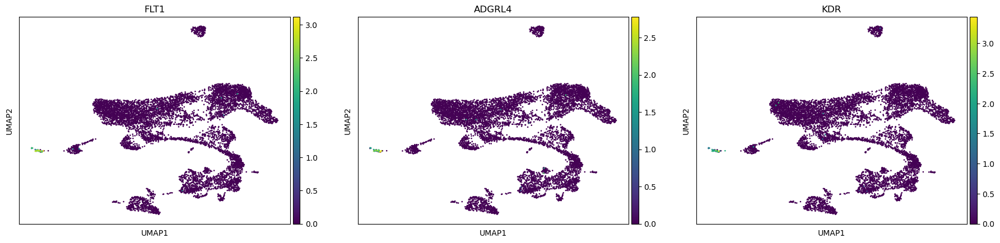

Ependymal


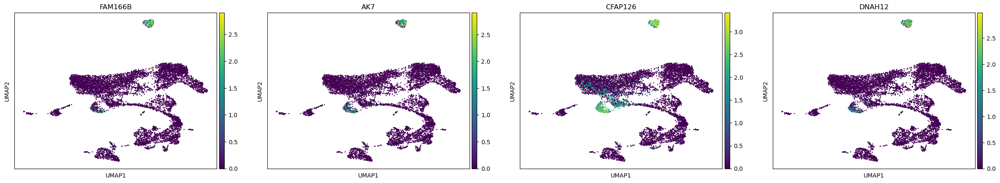

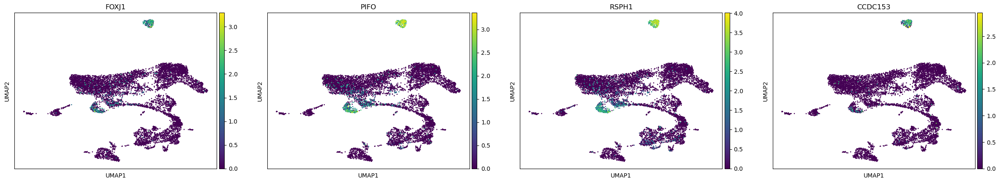

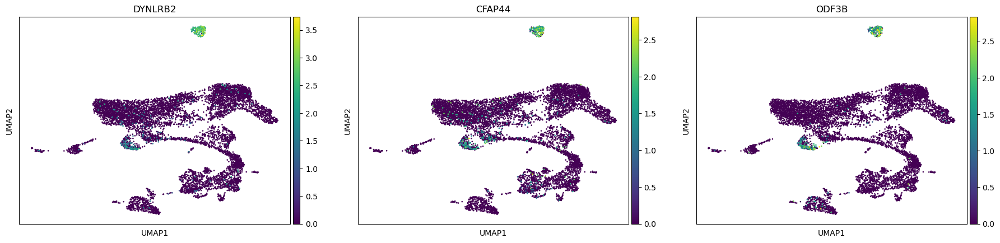

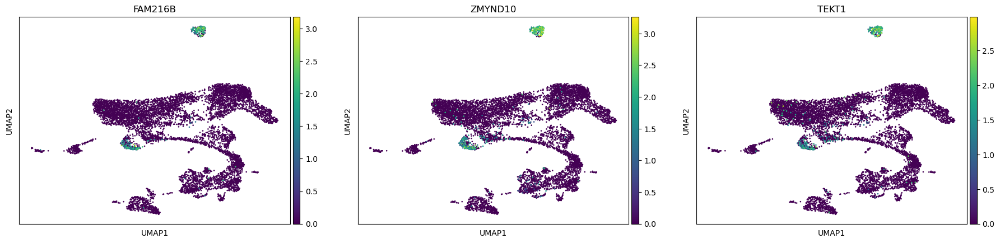

In [80]:
print("Microglia:")
sc.pl.umap(GW25_adata, color=["CX3CR1","P2RY12", "CD68"])

print("Astrocyte:")
sc.pl.umap(GW25_adata, color=["AQP4", "ALDOC", "GFAP"])
sc.pl.umap(GW25_adata, color=["VIM", "APOE", "GJA1"])

print("Radial glia")
sc.pl.umap(GW25_adata, color=["TNC", "FAM107A", "HOPX"])
sc.pl.umap(GW25_adata, color=["LIFR", "CRYAB", "GFAP"])
sc.pl.umap(GW25_adata, color=["PAX6", "VCAM1"])

print("Oligodendrocyte:")
sc.pl.umap(GW25_adata, color=["PDGFRA", "SOX10", "OLIG1"])
sc.pl.umap(GW25_adata, color=["OLIG2", "MBP", "PLP1"])


print("Dividing progenitor:")
sc.pl.umap(GW25_adata, color=["ASCL1", "EGFR", "EGR1", "VIM"])

print("Pericyte:")
sc.pl.umap(GW25_adata, color=["NDUFA4L2", "HIGD1B", "CTGF"])
sc.pl.umap(GW25_adata, color=["INPP4B", "IFITM1", "TBX18"])


print("Endothelial")
sc.pl.umap(GW25_adata, color=["PECAM1", "CLDN5", "CD34"])
sc.pl.umap(GW25_adata, color=["VWF", "CDH5", "CD93"])
sc.pl.umap(GW25_adata, color=["FLT1", "ADGRL4", "KDR"])

print("Ependymal")
sc.pl.umap(GW25_adata, color=["FAM166B", "AK7", "CFAP126", "DNAH12"])
sc.pl.umap(GW25_adata, color=["FOXJ1", "PIFO", "RSPH1", "CCDC153"])
sc.pl.umap(GW25_adata, color=["DYNLRB2", "CFAP44","ODF3B"])
sc.pl.umap(GW25_adata, color=["FAM216B", "ZMYND10", "TEKT1"])

In [53]:
sc.tl.filter_rank_genes_groups(GW25_adata, min_fold_change=1)

In [ ]:
sc.tl.rank_genes_groups(GW25_adata, 'leiden', method='t-test')

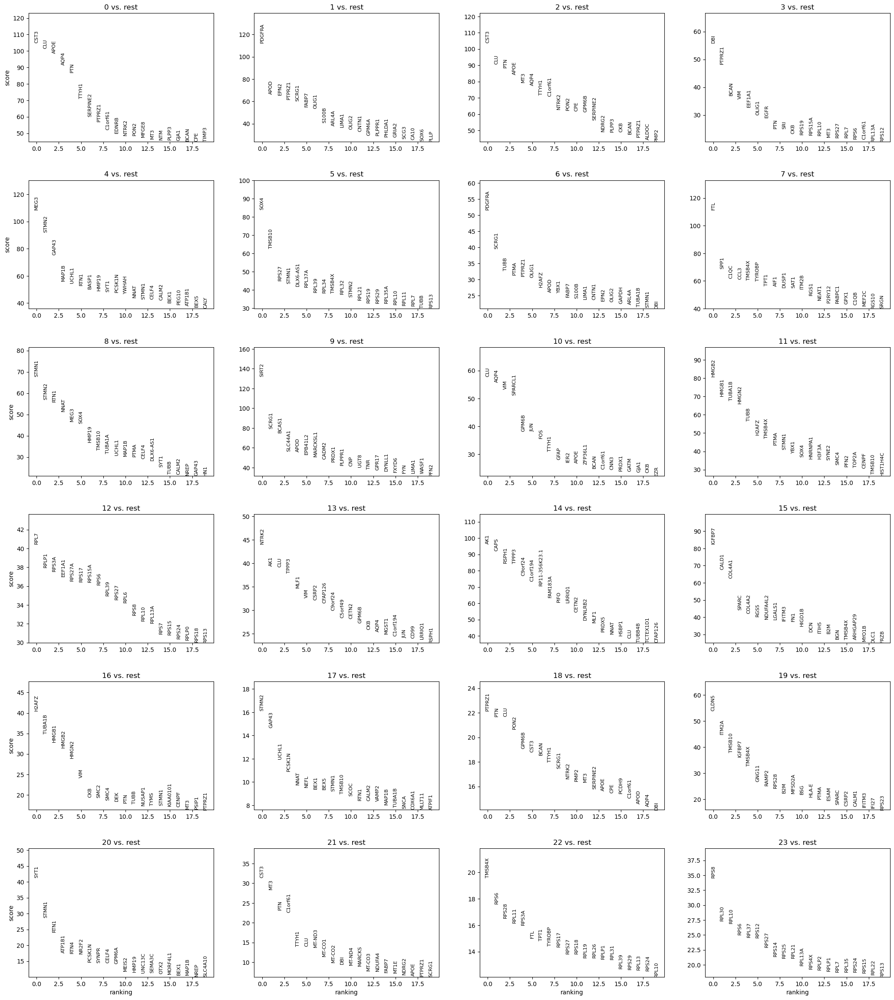

In [101]:
sc.pl.rank_genes_groups(GW25_adata, n_genes=20, sharey=False)


In [239]:
dedf = sc.get.rank_genes_groups_df(cs22_1_adata, group="2")
list(dedf["names"].values)[0:10]

['TMSB10',
 'STMN2',
 'RPL10',
 'TUBB2B',
 'RPL13A',
 'ACTG1',
 'EEF1A1',
 'RPL34',
 'FTH1',
 'RPS14']

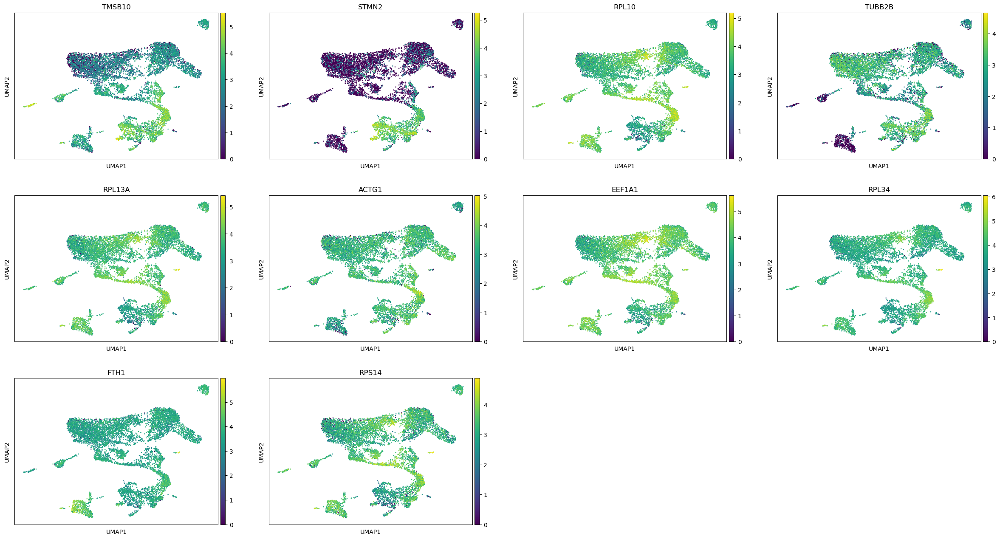

In [241]:
sc.pl.umap(GW25_adata, color=['TMSB10',
 'STMN2',
 'RPL10',
 'TUBB2B',
 'RPL13A',
 'ACTG1',
 'EEF1A1',
 'RPL34',
 'FTH1',
 'RPS14'])
